# 10x PAGA

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import doubletdetection
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
warnings.filterwarnings('ignore')

import logging
mpl_logger = logging.getLogger('matplotlib')
mpl_logger.setLevel(logging.WARNING) 

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()

/home/lebrigand/.conda/envs/jupyter/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


scanpy==1.4.5.2.dev9+g69419872 anndata==0.7.1 umap==0.3.10 numpy==1.17.3 scipy==1.4.1 pandas==0.25.3 scikit-learn==0.21.3 statsmodels==0.10.2 python-igraph==0.7.1 louvain==0.6.1


In [2]:
sc.settings.set_figure_params(dpi=130)

# WT
[Back to top](#wt)

In [3]:
adata_ann = sc.read_h5ad('./output/wt.ann.h5ad')
adata_raw = sc.read_h5ad('./output/wt.preprocessing.h5ad')
adata_raw.shape

(3291, 12958)

# PAGA all clusters

In [4]:
sc.tl.paga(adata_ann, groups='cell_type')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])


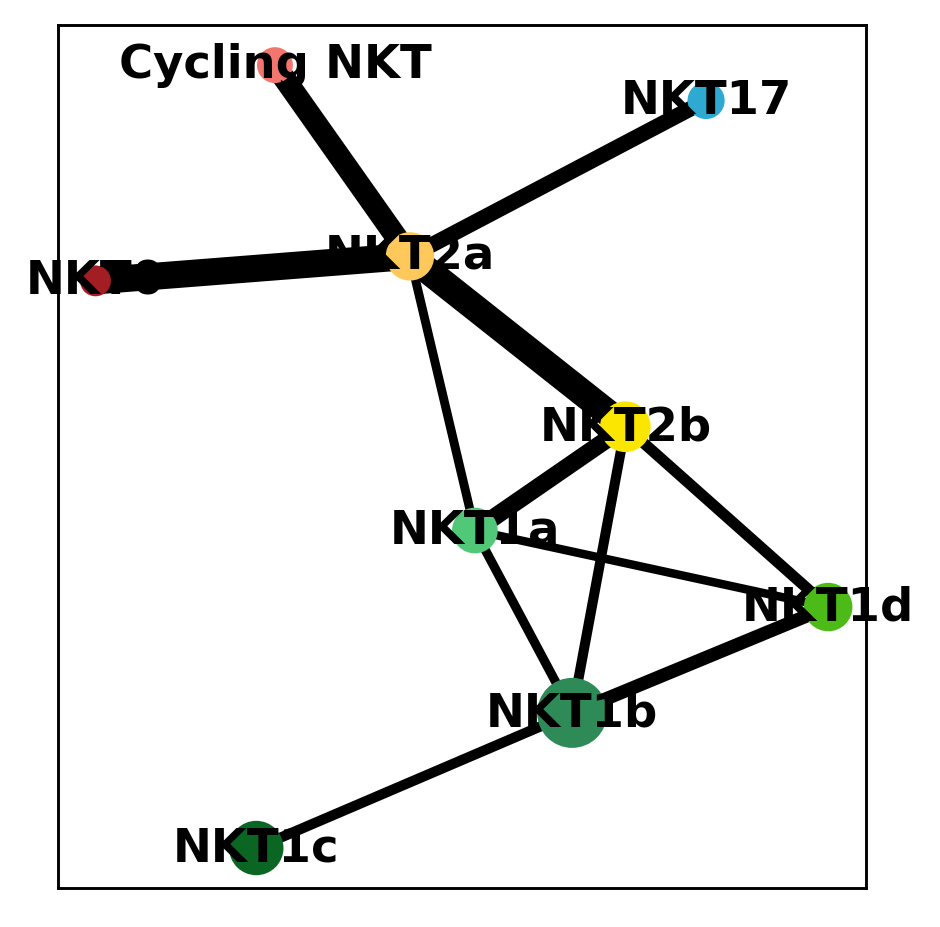

In [5]:
sc.pl.paga(adata_ann, color=['cell_type'], threshold=0.3)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:20)


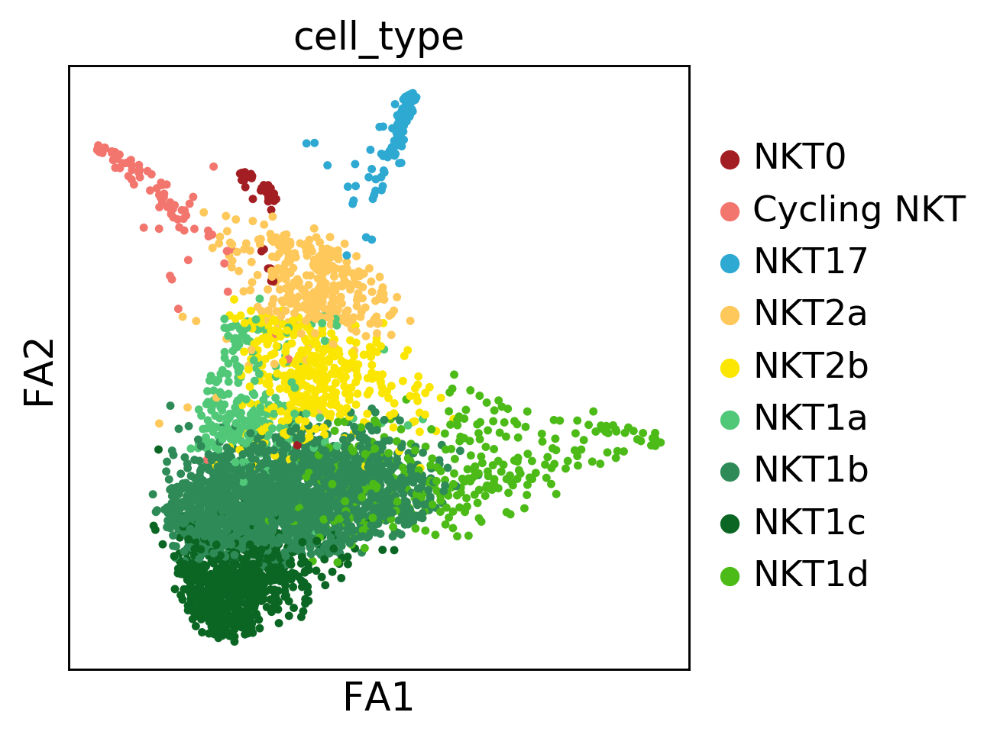

In [6]:
sc.tl.draw_graph(adata_ann, init_pos='paga')
sc.pl.draw_graph(adata_ann, color=['cell_type'])

--> added 'pos', the PAGA positions (adata.uns['paga'])


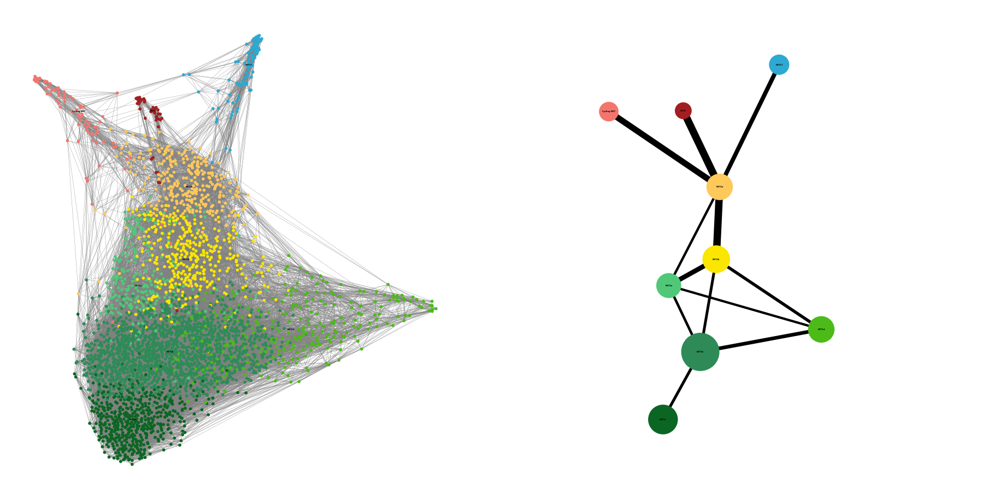

In [7]:
sc.pl.paga_compare(
    adata_ann, threshold=0.3, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=0, fontsize=0, frameon=False, edges=True)

--> added 'pos', the PAGA positions (adata.uns['paga'])


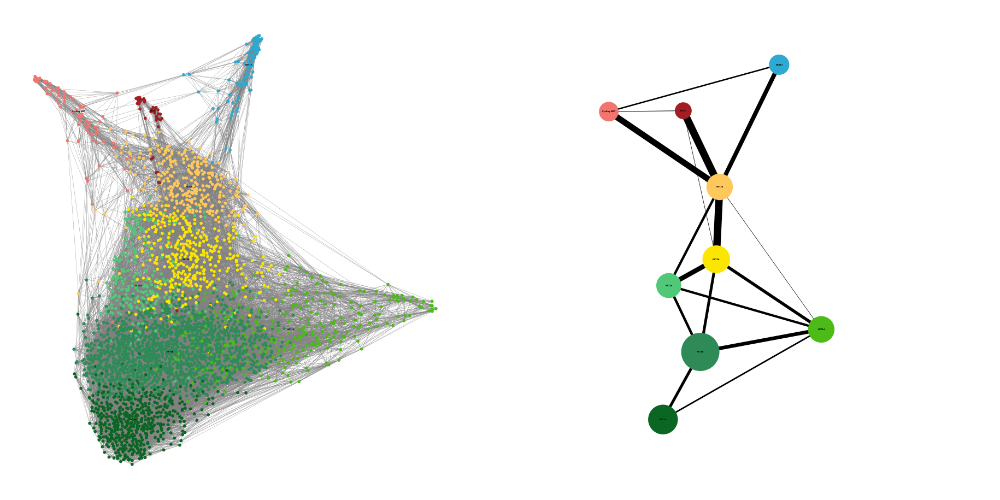

In [8]:
sc.pl.paga_compare(
    adata_ann, threshold=0.05, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=0, fontsize=0, frameon=False, edges=True)

--> added 'pos', the PAGA positions (adata.uns['paga'])


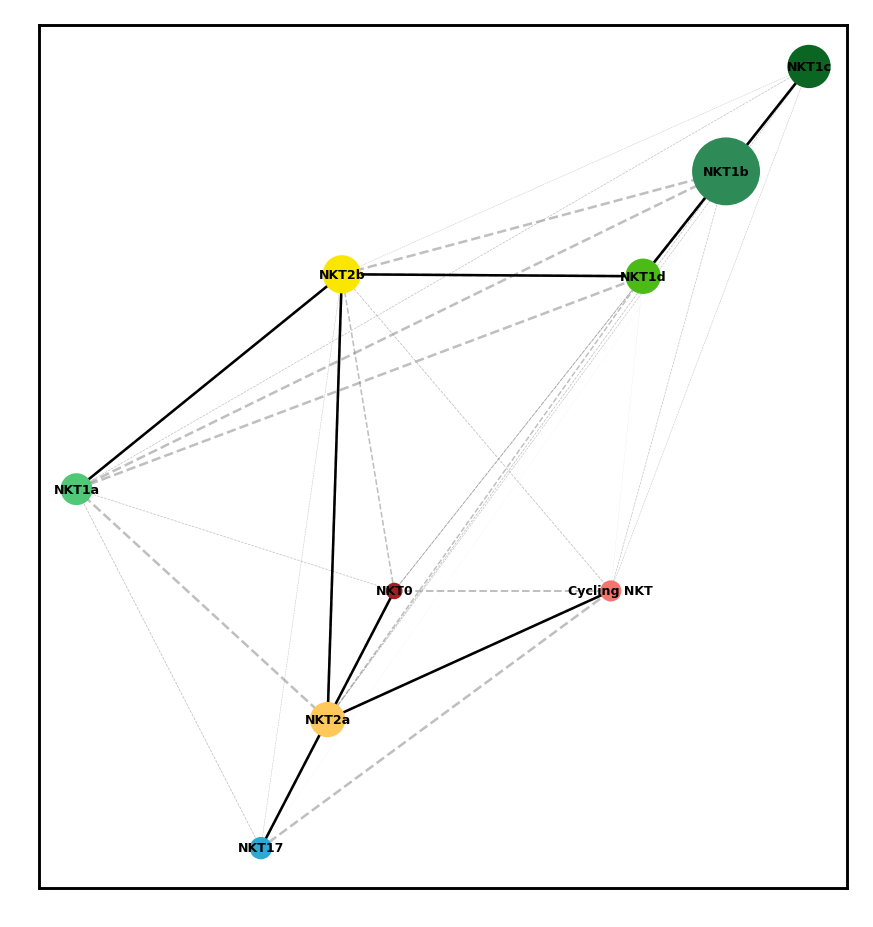

In [9]:
sc.pl.paga(adata_ann,
    threshold=0,           
    solid_edges='connectivities_tree',
    dashed_edges='connectivities',
    layout='rt_circular',
    node_size_scale=0.5,
    node_size_power=0.9,
    max_edge_width=0.7,
    fontsize=3.5)

# Genes by genes

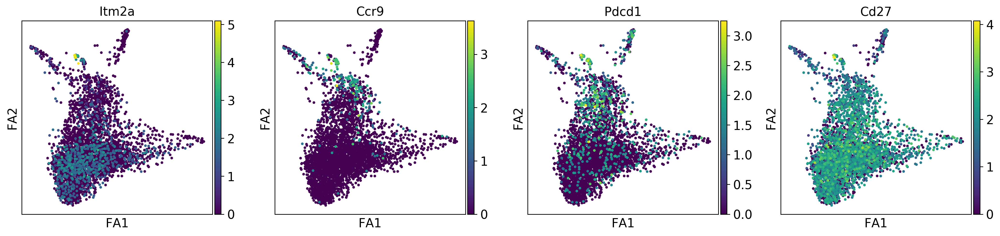

In [10]:
sc.pl.draw_graph(adata_ann, color=['Itm2a', 'Ccr9', 'Pdcd1', 'Cd27'], legend_loc='on data')

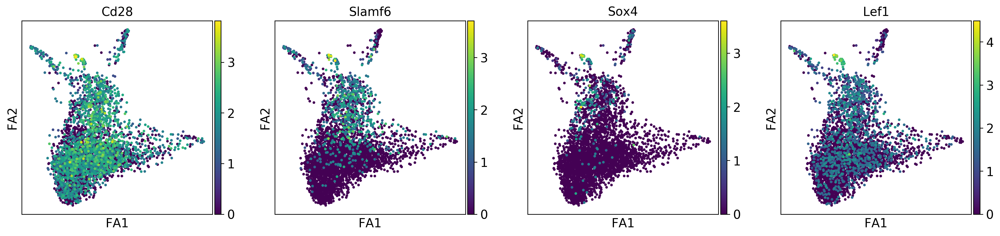

In [11]:
sc.pl.draw_graph(adata_ann, color=['Cd28', 'Slamf6', 'Sox4', 'Lef1'], legend_loc='on data')

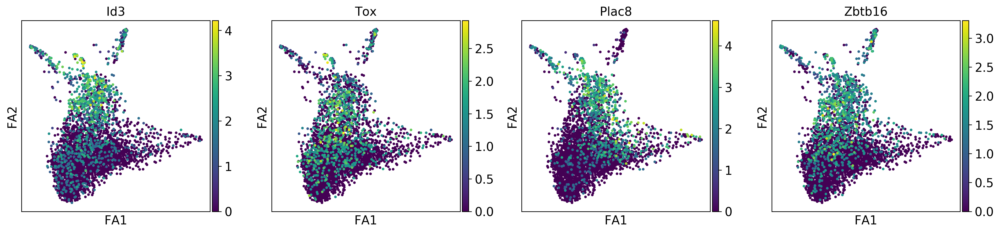

In [12]:
sc.pl.draw_graph(adata_ann, color=['Id3', 'Tox', 'Plac8', 'Zbtb16'], legend_loc='on data')

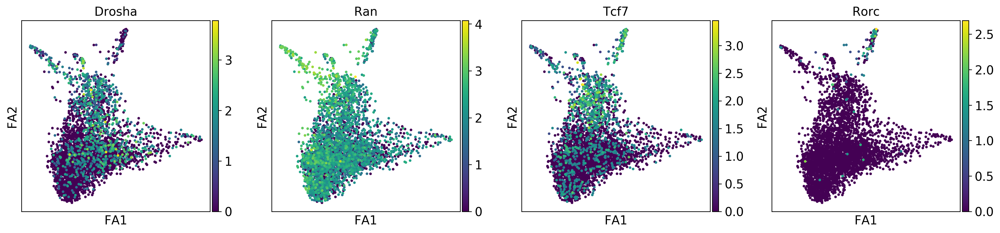

In [13]:
sc.pl.draw_graph(adata_ann, color=['Drosha', 'Ran', 'Tcf7', 'Rorc'], legend_loc='on data')

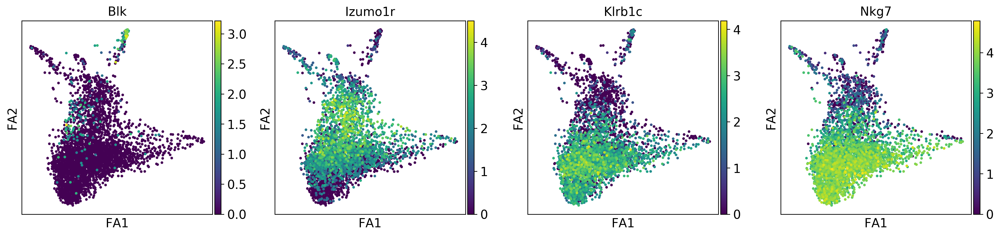

In [14]:
sc.pl.draw_graph(adata_ann, color=['Blk', 'Izumo1r', 'Klrb1c', 'Nkg7'], legend_loc='on data')

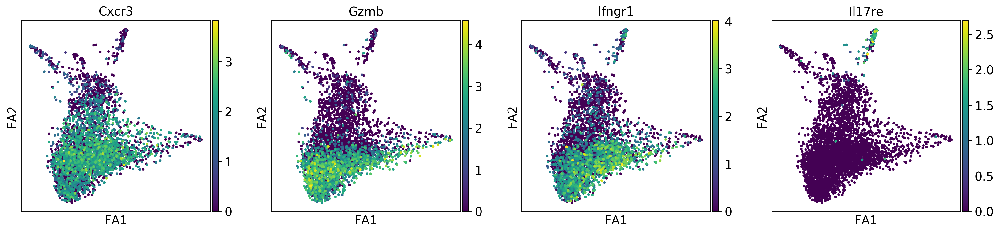

In [15]:
sc.pl.draw_graph(adata_ann, color=['Cxcr3', 'Gzmb', 'Ifngr1', 'Il17re'], legend_loc='on data')

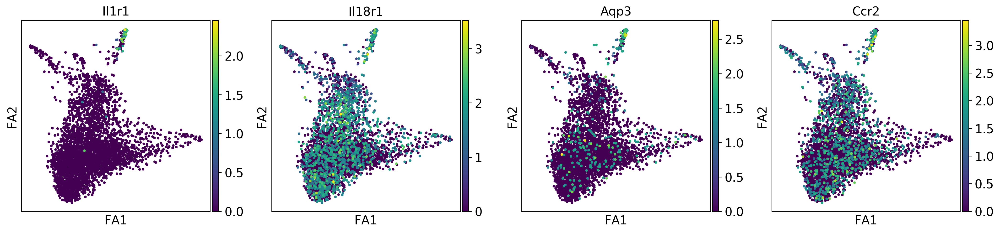

In [16]:
sc.pl.draw_graph(adata_ann, color=['Il1r1', 'Il18r1', 'Aqp3','Ccr2'], legend_loc='on data')

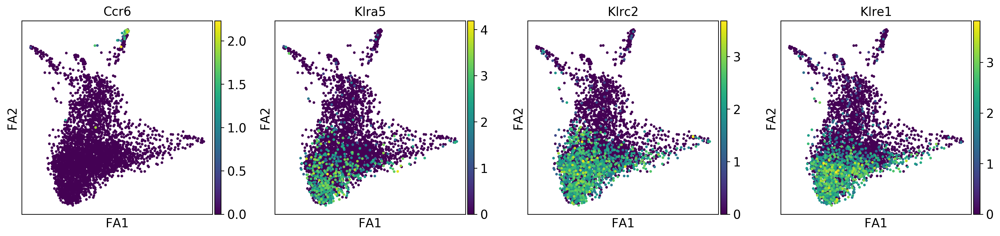

In [17]:
sc.pl.draw_graph(adata_ann, color=['Ccr6', 'Klra5', 'Klrc2', 'Klre1'], legend_loc='on data')

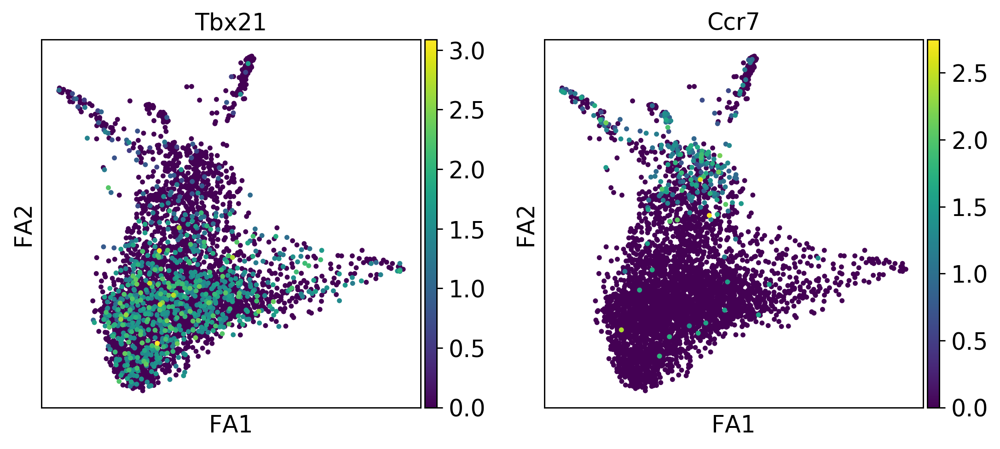

In [18]:
sc.pl.draw_graph(adata_ann, color=['Tbx21', 'Ccr7'], legend_loc='on data')

# PAGA without Cycling and NKT1d cells

In [19]:
cell_bool = []
for x in adata_ann.obs['cell_type']:
    cell_bool = cell_bool + [x in ['NKT0','NKT17','NKT2a','NKT2b','NKT1a','NKT1b','NKT1c']]

In [20]:
list_of_cell_names = adata_ann.obs.loc[cell_bool, :].index.tolist()
adata_ann = adata_ann[list_of_cell_names, ]
adata_ann.shape

(2916, 12958)

In [21]:
sc.tl.paga(adata_ann, groups='cell_type')

running PAGA


Trying to set attribute `.uns` of view, copying.


    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:01)


--> added 'pos', the PAGA positions (adata.uns['paga'])


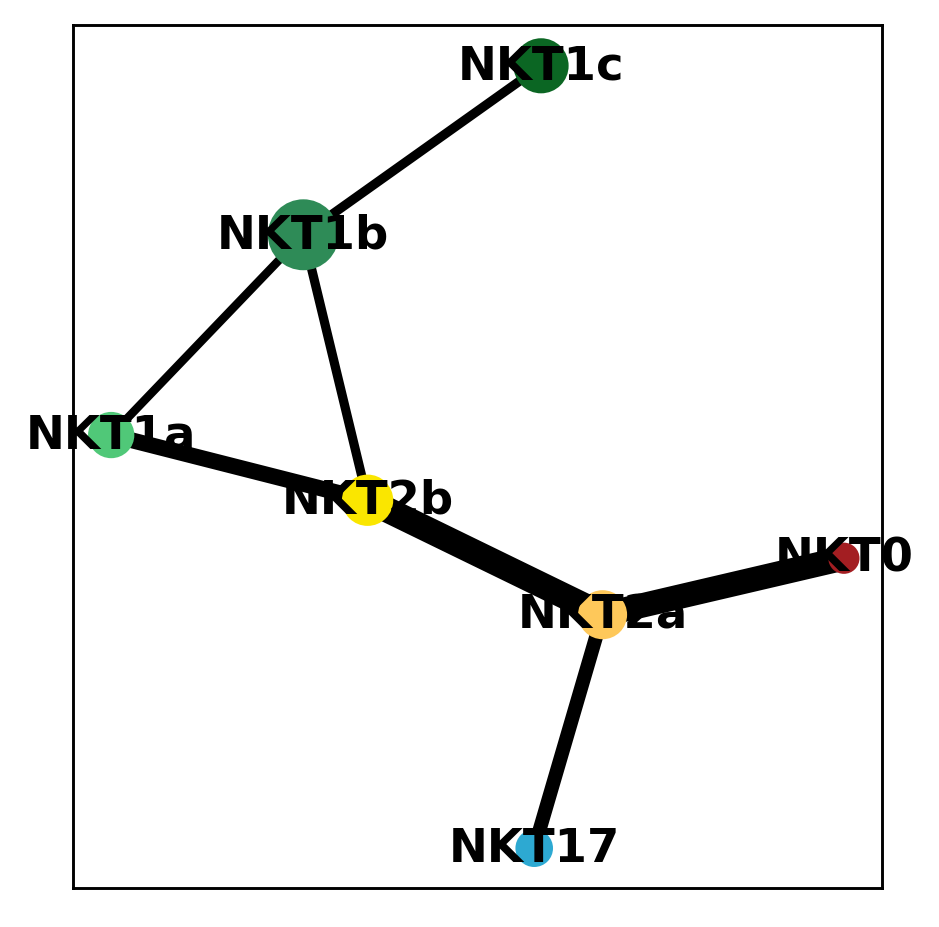

In [22]:
sc.pl.paga(adata_ann, color=['cell_type'], threshold=0.3)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:17)


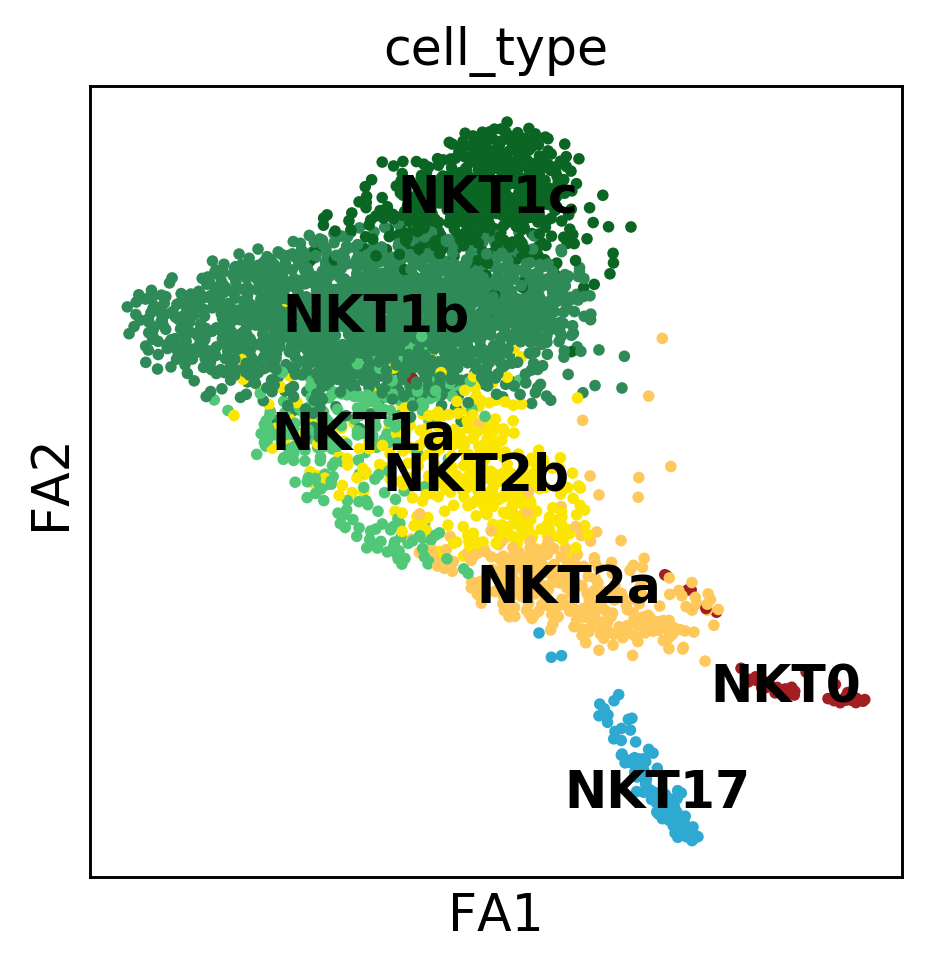

In [23]:
sc.tl.draw_graph(adata_ann, init_pos='paga')
sc.pl.draw_graph(adata_ann, color=['cell_type'], legend_loc='on data')

--> added 'pos', the PAGA positions (adata.uns['paga'])


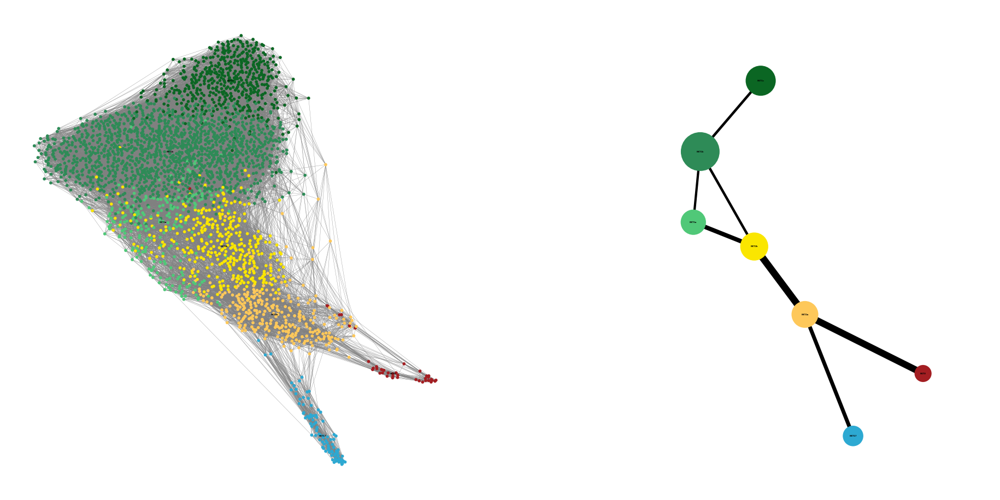

In [24]:
sc.pl.paga_compare(
    adata_ann, threshold=0.3, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=0, fontsize=0, frameon=False, edges=True)

--> added 'pos', the PAGA positions (adata.uns['paga'])


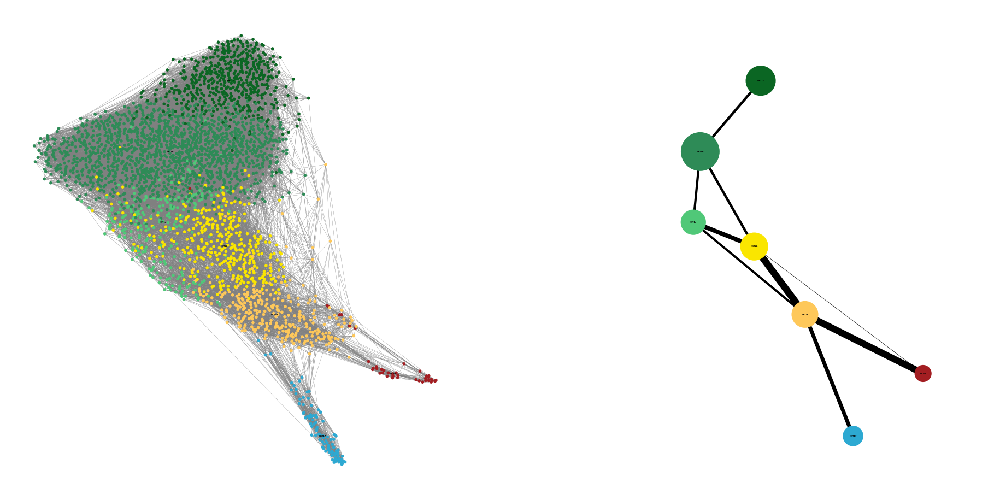

In [25]:
sc.pl.paga_compare(
    adata_ann, threshold=0.05, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=0, fontsize=0, frameon=False, edges=True)

--> added 'pos', the PAGA positions (adata.uns['paga'])


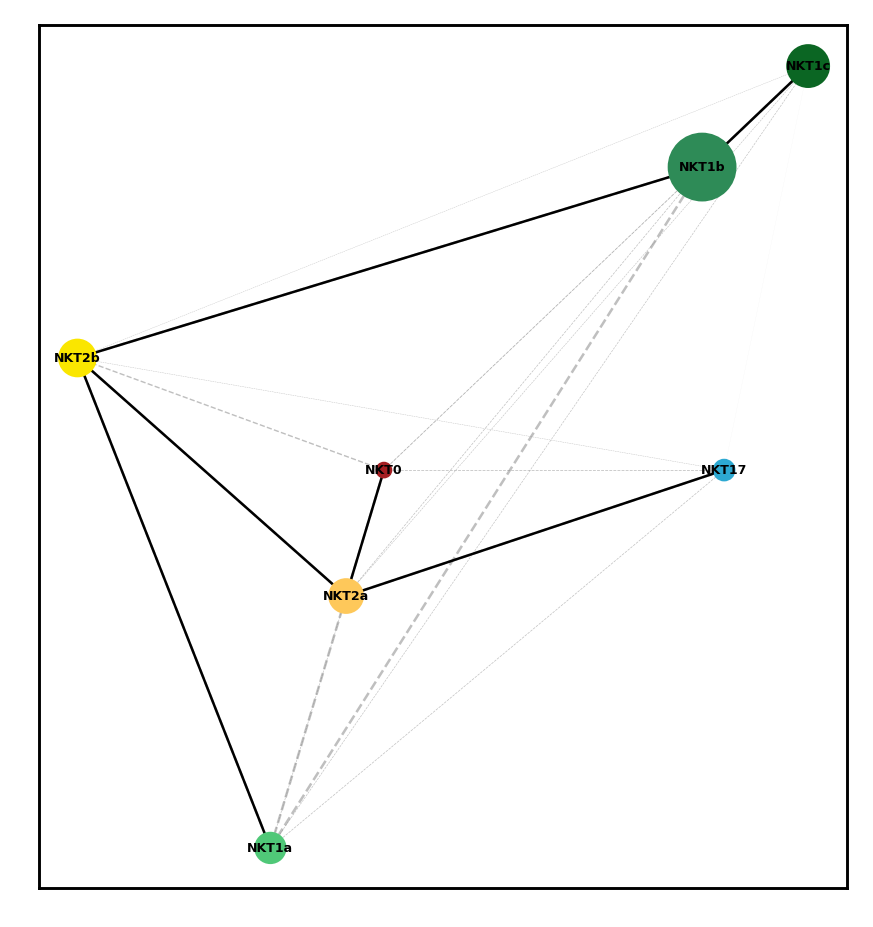

In [26]:
sc.pl.paga(adata_ann,
    threshold=0,           
    solid_edges='connectivities_tree',
    dashed_edges='connectivities',
    layout='rt_circular',
    node_size_scale=0.5,
    node_size_power=0.9,
    max_edge_width=0.7,
    fontsize=3.5)

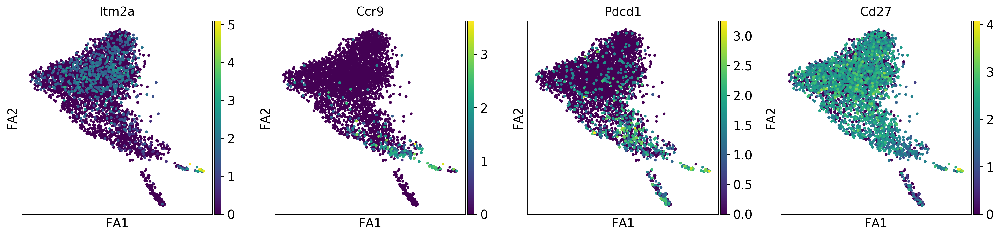

In [27]:
sc.pl.draw_graph(adata_ann, color=['Itm2a', 'Ccr9', 'Pdcd1', 'Cd27'], legend_loc='on data')

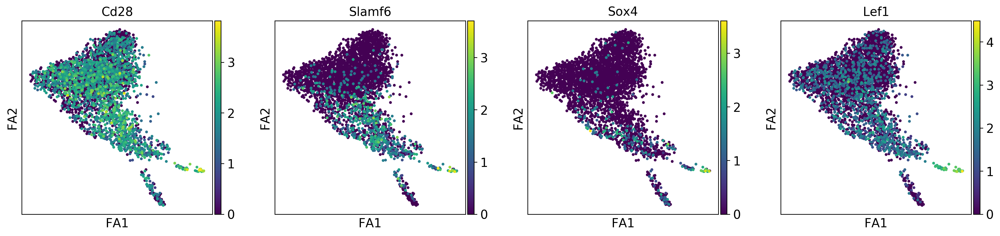

In [28]:
sc.pl.draw_graph(adata_ann, color=['Cd28', 'Slamf6', 'Sox4', 'Lef1'], legend_loc='on data')

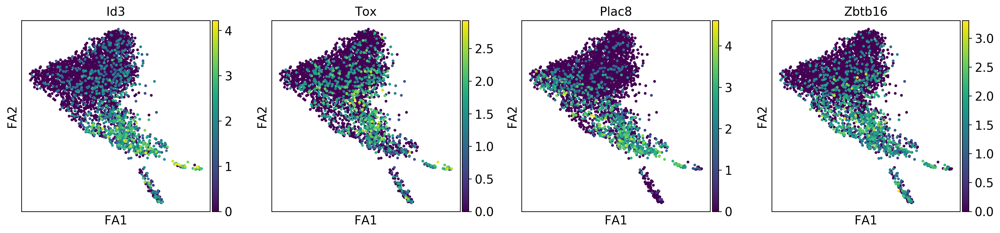

In [29]:
sc.pl.draw_graph(adata_ann, color=['Id3', 'Tox', 'Plac8', 'Zbtb16'], legend_loc='on data')

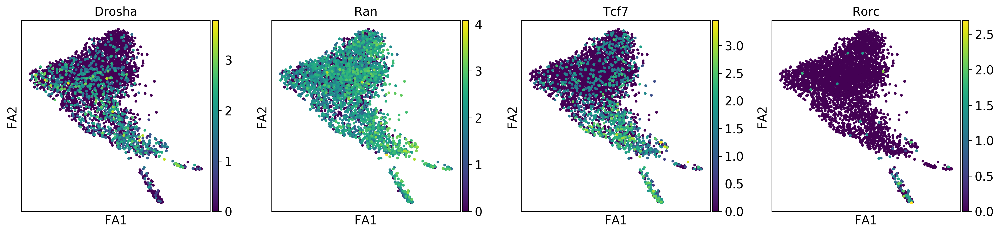

In [30]:
sc.pl.draw_graph(adata_ann, color=['Drosha', 'Ran', 'Tcf7', 'Rorc'], legend_loc='on data')

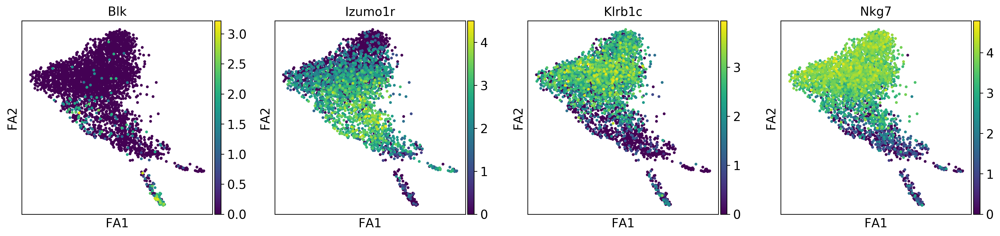

In [31]:
sc.pl.draw_graph(adata_ann, color=['Blk', 'Izumo1r', 'Klrb1c', 'Nkg7'], legend_loc='on data')

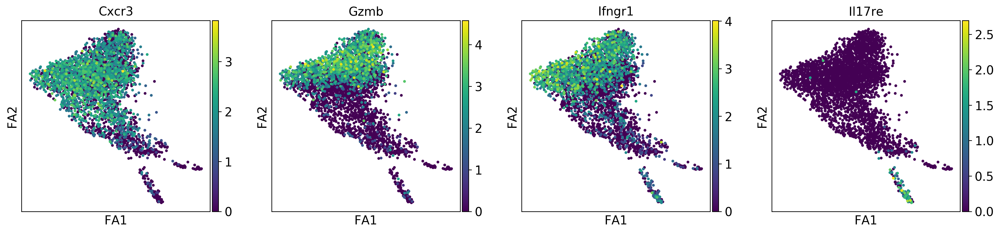

In [32]:
sc.pl.draw_graph(adata_ann, color=['Cxcr3', 'Gzmb', 'Ifngr1', 'Il17re'], legend_loc='on data')

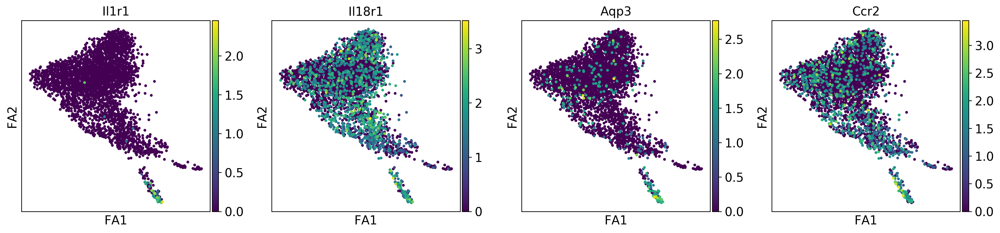

In [33]:
sc.pl.draw_graph(adata_ann, color=['Il1r1', 'Il18r1', 'Aqp3','Ccr2'], legend_loc='on data')

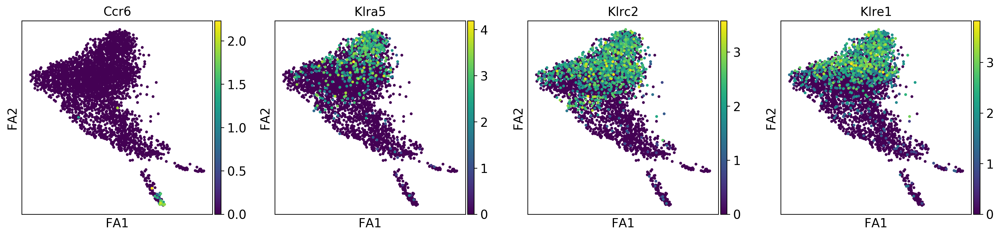

In [34]:
sc.pl.draw_graph(adata_ann, color=['Ccr6', 'Klra5', 'Klrc2', 'Klre1'], legend_loc='on data')

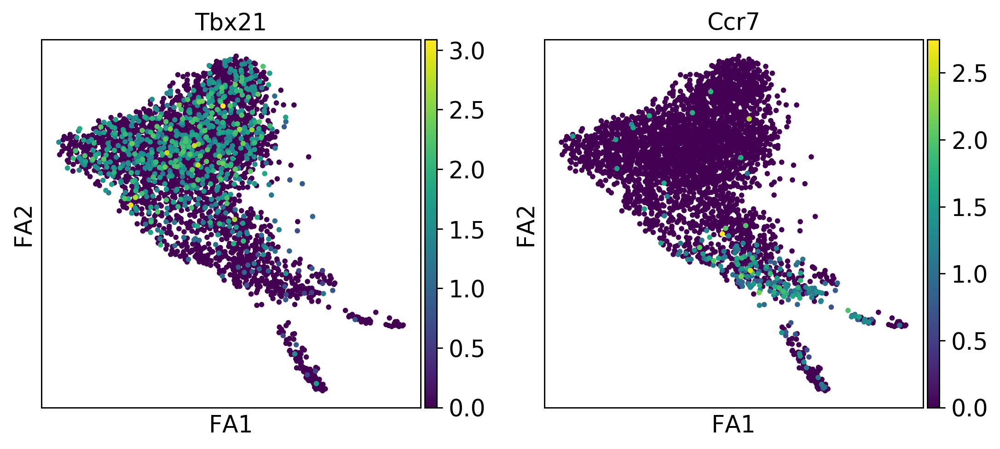

In [35]:
sc.pl.draw_graph(adata_ann, color=['Tbx21', 'Ccr7'], legend_loc='on data')

# KO without Cycling and NKT1d
[Back to top](#wt)

In [37]:
adata_ann = sc.read_h5ad('./output/ko.ann.h5ad')
adata_raw = sc.read_h5ad('./output/ko.preprocessing.h5ad')
adata_raw.shape

(4068, 13720)

In [38]:
cell_bool = []
for x in adata_ann.obs['cell_type']:
    cell_bool = cell_bool + [x in ['NKT0','NKT17','NKT2a','NKT2b','NKT1a','NKT1b','NKT1c']]

In [39]:
list_of_cell_names = adata_ann.obs.loc[cell_bool, :].index.tolist()
adata_ann = adata_ann[list_of_cell_names, ]
adata_ann.shape

(3336, 13720)

In [40]:
sc.tl.paga(adata_ann, groups='cell_type')

running PAGA


Trying to set attribute `.uns` of view, copying.


    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])


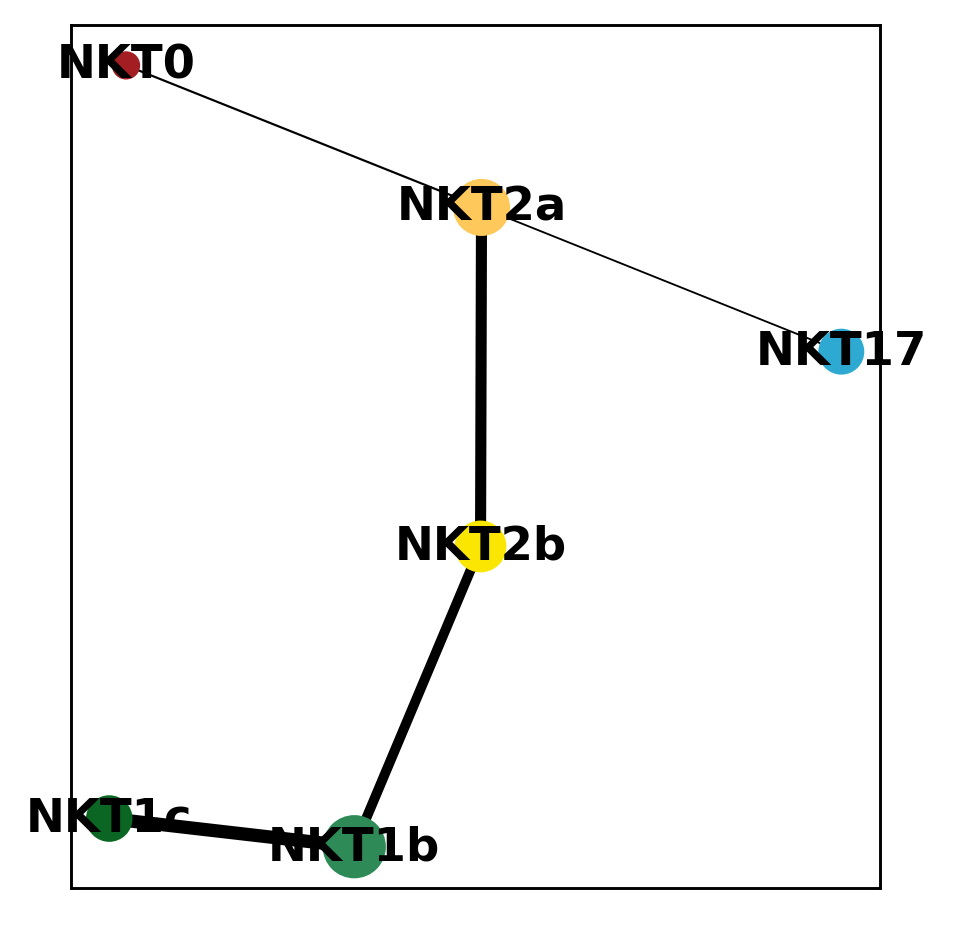

In [41]:
sc.pl.paga(adata_ann, color=['cell_type'], threshold=0.05)

In [ ]:
sc.tl.draw_graph(adata_ann, init_pos='paga')
sc.pl.draw_graph(adata_ann, color=['cell_type'], legend_loc='on data')

drawing single-cell graph using layout 'fa'


In [ ]:
sc.pl.paga_compare(
    adata_ann, threshold=0.3, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=0, fontsize=0, frameon=False, edges=True)

In [ ]:
sc.pl.paga_compare(
    adata_ann, threshold=0.05, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=0, fontsize=0, frameon=False, edges=True)

In [ ]:
sc.pl.paga(adata_ann,
    threshold=0,           
    solid_edges='connectivities_tree',
    dashed_edges='connectivities',
    layout='rt_circular',
    node_size_scale=0.5,
    node_size_power=0.9,
    max_edge_width=0.7,
    fontsize=3.5)

In [ ]:
sc.pl.draw_graph(adata_ann, color=['Itm2a', 'Ccr9', 'Pdcd1', 'Cd27'], legend_loc='on data')

In [ ]:
sc.pl.draw_graph(adata_ann, color=['Cd28', 'Slamf6', 'Sox4', 'Lef1'], legend_loc='on data')

In [ ]:
sc.pl.draw_graph(adata_ann, color=['Id3', 'Tox', 'Plac8', 'Zbtb16'], legend_loc='on data')

In [ ]:
sc.pl.draw_graph(adata_ann, color=['Drosha', 'Ran', 'Tcf7', 'Rorc'], legend_loc='on data')

In [ ]:
sc.pl.draw_graph(adata_ann, color=['Blk', 'Izumo1r', 'Klrb1c', 'Nkg7'], legend_loc='on data')

In [ ]:
sc.pl.draw_graph(adata_ann, color=['Cxcr3', 'Gzmb', 'Ifngr1', 'Il17re'], legend_loc='on data')

In [ ]:
sc.pl.draw_graph(adata_ann, color=['Il1r1', 'Il18r1', 'Aqp3','Ccr2'], legend_loc='on data')

In [ ]:
sc.pl.draw_graph(adata_ann, color=['Ccr6', 'Klra5', 'Klrc2', 'Klre1'], legend_loc='on data')

In [ ]:
sc.pl.draw_graph(adata_ann, color=['Tbx21', 'Ccr7'], legend_loc='on data')